<a href="https://colab.research.google.com/github/PaulPawelec/DataMining/blob/main/Airbnb/Paris.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

## 1. Załadowanie danych dotyczących wynajmu lokali z platformy Airbnb dla miasta Paris

In [ ]:
df = pd.read_csv("http://data.insideairbnb.com/france/ile-de-france/paris/2022-09-09/data/listings.csv.gz")

## 2. Rozmiar analizowanych danych wynosi 61365, dane zawierają 75 kolumn

3 typy danych float, int i object

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61365 entries, 0 to 61364
Data columns (total 75 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            61365 non-null  int64  
 1   listing_url                                   61365 non-null  object 
 2   scrape_id                                     61365 non-null  int64  
 3   last_scraped                                  61365 non-null  object 
 4   source                                        61365 non-null  object 
 5   name                                          61324 non-null  object 
 6   description                                   60619 non-null  object 
 7   neighborhood_overview                         35219 non-null  object 
 8   picture_url                                   61364 non-null  object 
 9   host_id                                       61365 non-null 

## 3. Wyświetlenie próbki danych

In [ ]:
pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)

In [ ]:
df.head(5)

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,130420,https://www.airbnb.com/rooms/130420,20220909140132,2022-09-10,city scrape,Charming Apartment 2BR in Paris 9e,This quiet and bright flat is situated on the ...,The neighborhood of rue des Martyrs captures t...,https://a0.muscache.com/pictures/947410/5cb34c...,641777,https://www.airbnb.com/users/show/641777,Yassine,2011-05-30,"Paris, France",Je suis juriste et je poursuis mes études pour...,within a few hours,100%,92%,t,https://a0.muscache.com/im/pictures/user/285ce...,https://a0.muscache.com/im/pictures/user/285ce...,Pigalle - Saint-Georges,1.0,1.0,"['email', 'phone']",t,t,"Paris, Ile-de-France, France",Opéra,NaN,48.88073,2.34297,Entire rental unit,Entire home/apt,6,NaN,1 bath,2.0,3.0,"[""Ethernet connection"", ""Hair dryer"", ""Hangers...",$213.00,1,30,1.0,1.0,1125.0,1125.0,1.0,1125.0,NaN,t,4,26,38,301,2022-09-10,188,32,2,2011-06-30,2022-09-06,4.60,4.66,4.37,4.94,4.96,4.81,4.43,7510900711502,f,1,1,0,0,1.38
1,23441,https://www.airbnb.com/rooms/23441,20220909140132,2022-09-10,city scrape,Charming at Montmartre & rue Lepic- mobility l...,This small charming apartment situated in the ...,NaN,https://a0.muscache.com/pictures/501057/ef0d26...,91706,https://www.airbnb.com/users/show/91706,Elise,2010-03-12,"Paris, France",I am originally from a small village in Norway...,within a day,100%,100%,t,https://a0.muscache.com/im/users/91706/profile...,https://a0.muscache.com/im/users/91706/profile...,Montmartre,1.0,3.0,"['email', 'phone']",t,t,NaN,Buttes-Montmartre,NaN,48.88408,2.33478,Entire rental unit,Entire home/apt,2,NaN,1 bath,NaN,1.0,"[""Heating"", ""Hair dryer"", ""Cooking basics"", ""S...",$70.00,30,305,30.0,30.0,305.0,305.0,30.0,305.0,NaN,t,0,0,0,115,2022-09-10,84,3,1,2010-04-04,2022-08-31,4.72,4.57,4.60,4.83,4.96,4.63,4.64,"Available with a mobility lease only (""bail mo...",f,1,1,0,0,0.55
2,5396,https://www.airbnb.com/rooms/5396,20220909140132,2022-09-10,city scrape,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",https://a0.muscache.com/pictures/52413/f9bf76f...,7903,https://www.airbnb.com/users/show/7903,Borzou,2009-02-14,"İstanbul, Turkey",The flat is owned by journalists who spend a l...,within an hour,100%,99%,f,https://a0.muscache.com/im/users/7903/profile_...,https://a0.muscache.com/im/users/7903/profile_...,Saint-Paul - Ile Saint-Louis,1.0,1.0,"['email', 'phone']",t,t,"Paris, Ile-de-France, France",Hôtel-de-Ville,NaN,48.85247,2.35835,Entire rental unit,Entire home/apt,2,NaN,1 bath,NaN,1.0,"[""Hair dryer"", ""Toaster"", ""Hangers"", ""Kitchen""...",$110.00,1,1125,1.0,1.0,1125.0,1125.0,1.0,1125.0,NaN,t,4,20,50,50,2022-09-10,309,48,

## 4. Weryfikacja typów danych
występują 3 rodzaje typów danych: object, int, float.
Można zauważyć, że powinien wystąpić typ daty lub zmienne logiczne w niektórych z kolumn, np. kolumna "first_review" i "last_review" powinny mieć typ daty patrząc na dane zawierające w tej kolumnie.

In [ ]:
df.dtypes

id                                                int64
listing_url                                      object
scrape_id                                         int64
last_scraped                                     object
source                                           object
name                                             object
description                                      object
neighborhood_overview                            object
picture_url                                      object
host_id                                           int64
host_url                                         object
host_name                                        object
host_since                                       object
host_location                                    object
host_about                                       object
host_response_time                               object
host_response_rate                               object
host_acceptance_rate                            

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61365 entries, 0 to 61364
Data columns (total 75 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            61365 non-null  int64  
 1   listing_url                                   61365 non-null  object 
 2   scrape_id                                     61365 non-null  int64  
 3   last_scraped                                  61365 non-null  object 
 4   source                                        61365 non-null  object 
 5   name                                          61324 non-null  object 
 6   description                                   60619 non-null  object 
 7   neighborhood_overview                         35219 non-null  object 
 8   picture_url                                   61364 non-null  object 
 9   host_id                                       61365 non-null 

In [ ]:
df.first_review.head()

0   2011-06-30
1   2010-04-04
2   2009-06-30
3   2011-06-11
4   2011-04-08
Name: first_review, dtype: datetime64[ns]

In [ ]:
df.describe()

,id,scrape_id,host_id,host_listings_count,host_total_listings_count,neighbourhood_group_cleansed,latitude,longitude,accommodates,bathrooms,bedrooms,beds,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
count,6.136500e+04,6.136500e+04,6.136500e+04,61358.000000,61358.000000,0.0,61365.000000,61365.000000,61365.000000,0.0,51393.000000,60401.000000,61365.000000,6.136500e+04,61359.000000,61359.000000,6.135900e+04,6.135900e+04,61359.000000,6.135900e+04,0.0,61365.000000,61365.000000,61365.000000,61365.000000,61365.000000,61365.000000,61365.000000,49485.000000,48913.000000,48915.000000,48903.000000,48914.000000,48901.000000,48899.000000,61365.000000,61365.000000,61365.000000,61365.000000,49485.000000
mean,1.309215e+17,2.022091e+13,1.211832e+08,16.431892,26.267414,NaN,48.863505,2.343973,3.051951,NaN,1.372522,1.732637,81.193514,8.479040e+02,80.457472,84.203703,1.408867e+05,5.259088e+05,83.709950,2.791533e+05,NaN,3.936299,10.883158,20.064972,106.526945,23.910894,7.229007,0.642337,4.614329,4.752536,4.591424,4.790046,4.800128,4.784808,4.611347,11.083207,10.400636,0.495054,0.028550,1.095936
std,2.593087e+17,0.000000e+00,1.448137e+08,71.263845,127.172759,NaN,0.020843,0.040921,1.632589,NaN,0.967955,1.332412,151.562180,4.037193e+04,151.209095,157.026132,1.733848e+07,3.357275e+07,156.609793,2.145576e+07,NaN,7.754012,17.507903,28.840094,130.754534,51.986093,17.841936,1.631099,0.664381,0.419863,0.526259,0.405944,0.406898,0.356229,0.461448,35.334404,35.259561,2.933507,0.562298,1.574085
min,5.396000e+03,2.022091e+13,2.750000e+02,0.000000,1.000000,NaN,48.802740,2.206290,0.000000,NaN,1.000000,1.000000,1.000000,1.000000e+00,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.010000
25%,1.508621e+07,2.022091e+13,1.513374e+07,1.000000,1.000000,NaN,48.849300,2.319790,2.000000,NaN,1.000000,1.000000,2.000000,9.000000e+01,2.000000,2.000000,9.900000e+01,3.650000e+02,2.000000,2.245000e+02,NaN,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,4.500000,4.680000,4.440000,4.750000,4.770000,4.710000,4.500000,1.000000,1.000000,0.000000,0.000000,0.170000
50%,3.464377e+07,2.022091e+13,4.756324e+07,1.000000,2.000000,NaN,48.865163,2.347300,2.000000,NaN,1.000000,1.000000,3.000000,1.125000e+03,3.000000,4.000000,1.125000e+03,1.125000e+03,3.000000,1.125000e+03,NaN,0.000000,0.000000,1.000000,26.000000,6.000000,1.000000,0.000000,4.790000,4.880000,4.750000,4.920000,4.940000,4.900000,4.710000,1.000000,1.000000,0.000000,0.000000,0.570000
75%,5.235750e+07,2.022091e+13,1.933977e+08,2.000000,4.000000,NaN,48.879890,2.371490,4.000000,NaN,2.000000,2.000000,30.000000,1.125000e+03,30.000000,30.000000,1.125000e+03,1.125000e+03,30.000000,1.125000e+03,NaN,4.000000,15.000000,38.000000,231.000000,24.000000,8.000000,1.000000,5.000000,5.000000,4.960000,5.000000,5.000000,5.000000,4.890000,2.000000,1.000000,0.000000,0.000000,1.480000
max,7.119762e+17,2.022091e+13,4.787753e+08,1500.000000,2302.000000,NaN,48.913964,2.487620,16.000000,NaN,50.000000,90.000000,9999.000000,1.000000e+07,9999.000000,9999.000000,2.147484e+09,2.147484e+09,9999.000000,2.147484e+09,NaN,30.000000,60.000000,90.000000,365.000000,2391.000000,1356.000000,92.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,269.000000,269

sprawdzenie czy są duplikaty

In [ ]:
df.duplicated().sum()

0

Zmiana danych. Usunięcie $ i % i zamiana na typ float

In [ ]:
pd.set_option("display.max_rows", None)

In [ ]:
df['price']

0           $213.00
1            $70.00
2           $110.00
3            $90.00
4           $109.00
5            $85.00
6           $120.00
7           $120.00
8            $53.00
9           $120.00
10           $97.00
11           $50.00
12          $130.00
13          $100.00
14          $150.00
15           $75.00
16           $98.00
17          $130.00
18           $80.00
19          $175.00
20           $88.00
21           $50.00
22           $75.00
23          $120.00
24          $180.00
25          $160.00
26           $60.00
27          $110.00
28          $200.00
29           $80.00
30          $101.00
31           $75.00
32           $32.00
33          $160.00
34           $46.00
35          $157.00
36          $106.00
37          $110.00
38           $45.00
39           $85.00
40           $59.00
41          $800.00
42           $60.00
43           $60.00
44          $130.00
45           $60.00
46           $90.00
47          $139.00
48           $89.00
49          $124.00


In [ ]:
df['price'] = df['price'].str.replace('[$,]', '', regex=True).astype(np.float64)

In [ ]:
df['price']

0          213.0
1           70.0
2          110.0
3           90.0
4          109.0
5           85.0
6          120.0
7          120.0
8           53.0
9          120.0
10          97.0
11          50.0
12         130.0
13         100.0
14         150.0
15          75.0
16          98.0
17         130.0
18          80.0
19         175.0
20          88.0
21          50.0
22          75.0
23         120.0
24         180.0
25         160.0
26          60.0
27         110.0
28         200.0
29          80.0
30         101.0
31          75.0
32          32.0
33         160.0
34          46.0
35         157.0
36         106.0
37         110.0
38          45.0
39          85.0
40          59.0
41         800.0
42          60.0
43          60.0
44         130.0
45          60.0
46          90.0
47         139.0
48          89.0
49         124.0
50         170.0
51          49.0
52          45.0
53          90.0
54          62.0
55          98.0
56         105.0
57         190.0
58          70

In [ ]:
df.host_acceptance_rate.unique()

array(['92%', '100%', '99%', nan, '70%', '75%', '80%', '0%', '60%', '63%',
       '90%', '84%', '98%', '55%', '57%', '95%', '29%', '86%', '74%',
       '85%', '9%', '77%', '91%', '2%', '83%', '28%', '94%', '14%', '40%',
       '54%', '69%', '7%', '71%', '81%', '52%', '93%', '68%', '39%',
       '72%', '42%', '48%', '87%', '17%', '97%', '16%', '38%', '76%',
       '50%', '79%', '27%', '67%', '31%', '62%', '43%', '47%', '26%',
       '89%', '58%', '88%', '32%', '46%', '65%', '20%', '35%', '33%',
       '78%', '22%', '59%', '96%', '66%', '64%', '53%', '25%', '82%',
       '44%', '41%', '61%', '11%', '36%', '49%', '23%', '24%', '73%',
       '37%', '18%', '56%', '45%', '34%', '21%', '30%', '13%', '51%',
       '4%', '8%', '5%', '10%', '19%', '12%', '3%', '6%', '15%', '1%'],
      dtype=object)

In [ ]:
df.host_acceptance_rate

0         92%
1        100%
2         99%
3         NaN
4         70%
5         75%
6         80%
7          0%
8         60%
9        100%
10         0%
11         0%
12         0%
13        63%
14        90%
15         0%
16       100%
17        63%
18        84%
19        98%
20         0%
21        NaN
22        NaN
23         0%
24       100%
25        55%
26        NaN
27       100%
28        90%
29        57%
30        90%
31        57%
32        NaN
33        95%
34       100%
35        29%
36       100%
37        86%
38        74%
39        85%
40         9%
41       100%
42       100%
43        NaN
44        70%
45        NaN
46        77%
47        NaN
48         0%
49        75%
50        NaN
51        NaN
52        NaN
53        NaN
54        29%
55         0%
56        NaN
57        91%
58         2%
59        86%
60        55%
61        83%
62       100%
63        NaN
64        28%
65       100%
66        94%
67        99%
68        14%
69       100%
70        28%
71    

In [ ]:
df['host_acceptance_rate'] = df['host_acceptance_rate'].str.replace('%', '').astype(np.float64)/100

In [ ]:
df['host_acceptance_rate']

0        0.92
1        1.00
2        0.99
3         NaN
4        0.70
5        0.75
6        0.80
7        0.00
8        0.60
9        1.00
10       0.00
11       0.00
12       0.00
13       0.63
14       0.90
15       0.00
16       1.00
17       0.63
18       0.84
19       0.98
20       0.00
21        NaN
22        NaN
23       0.00
24       1.00
25       0.55
26        NaN
27       1.00
28       0.90
29       0.57
30       0.90
31       0.57
32        NaN
33       0.95
34       1.00
35       0.29
36       1.00
37       0.86
38       0.74
39       0.85
40       0.09
41       1.00
42       1.00
43        NaN
44       0.70
45        NaN
46       0.77
47        NaN
48       0.00
49       0.75
50        NaN
51        NaN
52        NaN
53        NaN
54       0.29
55       0.00
56        NaN
57       0.91
58       0.02
59       0.86
60       0.55
61       0.83
62       1.00
63        NaN
64       0.28
65       1.00
66       0.94
67       0.99
68       0.14
69       1.00
70       0.28
71    

In [ ]:
df['host_response_rate'] = df['host_response_rate'].str.replace('%', '').astype(np.float64)/100

In [ ]:
df['host_response_rate']

0        1.00
1        1.00
2        1.00
3         NaN
4        1.00
5        1.00
6        0.90
7        1.00
8        1.00
9        1.00
10        NaN
11        NaN
12        NaN
13       1.00
14       1.00
15        NaN
16       1.00
17       1.00
18       1.00
19       1.00
20       1.00
21        NaN
22        NaN
23        NaN
24       1.00
25       1.00
26        NaN
27       1.00
28       0.96
29       1.00
30       1.00
31       1.00
32        NaN
33       1.00
34       1.00
35       1.00
36       1.00
37       1.00
38       0.71
39       1.00
40       1.00
41       1.00
42       1.00
43        NaN
44       1.00
45        NaN
46       1.00
47        NaN
48       0.00
49       0.80
50        NaN
51        NaN
52        NaN
53        NaN
54       0.80
55       0.00
56        NaN
57       1.00
58       0.98
59       1.00
60       0.90
61       1.00
62       1.00
63       1.00
64       0.19
65       1.00
66       1.00
67       1.00
68       0.50
69       1.00
70       0.19
71    

Zmiana danych na True/False

In [ ]:
df.host_is_superhost.unique()

array(['t', 'f', nan], dtype=object)

In [ ]:
df.host_is_superhost = df.host_is_superhost.map({'t': True, 'f': False})

In [ ]:
df.host_is_superhost.fillna(False,inplace=True)

In [ ]:
df.has_availability = df.has_availability.map({'t': True, 'f': False})

In [ ]:
df.has_availability.fillna(False,inplace=True)

In [ ]:
df.instant_bookable = df.instant_bookable.map({'t': True, 'f': False})

In [ ]:
df.instant_bookable.fillna(False,inplace=True)

In [ ]:
df.host_has_profile_pic= df.host_has_profile_pic.map({'t': True, 'f': False})

In [ ]:
df.host_has_profile_pic.fillna(False,inplace=True)

In [ ]:
df.host_identity_verified= df.host_identity_verified.map({'t': True, 'f': False})

In [ ]:
df.host_identity_verified.fillna(False,inplace=True)

## 5. Podsumowanie zmiennych numerycznych

In [ ]:
df.describe(include='number')

,id,scrape_id,host_id,host_response_rate,host_acceptance_rate,host_listings_count,host_total_listings_count,neighbourhood_group_cleansed,latitude,longitude,accommodates,bathrooms,bedrooms,beds,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
count,6.136500e+04,6.136500e+04,6.136500e+04,36550.000000,39251.000000,61358.000000,61358.000000,0.0,61365.000000,61365.000000,61365.000000,0.0,51393.000000,60401.000000,61365.000000,61365.000000,6.136500e+04,61359.000000,61359.000000,6.135900e+04,6.135900e+04,61359.000000,6.135900e+04,0.0,61365.000000,61365.000000,61365.000000,61365.000000,61365.000000,61365.000000,61365.000000,49485.000000,48913.000000,48915.000000,48903.000000,48914.000000,48901.000000,48899.000000,61365.000000,61365.000000,61365.000000,61365.000000,49485.000000
mean,1.309215e+17,2.022091e+13,1.211832e+08,0.922585,0.813293,16.431892,26.267414,NaN,48.863505,2.343973,3.051951,NaN,1.372522,1.732637,161.811326,81.193514,8.479040e+02,80.457472,84.203703,1.408867e+05,5.259088e+05,83.709950,2.791533e+05,NaN,3.936299,10.883158,20.064972,106.526945,23.910894,7.229007,0.642337,4.614329,4.752536,4.591424,4.790046,4.800128,4.784808,4.611347,11.083207,10.400636,0.495054,0.028550,1.095936
std,2.593087e+17,0.000000e+00,1.448137e+08,0.182495,0.262306,71.263845,127.172759,NaN,0.020843,0.040921,1.632589,NaN,0.967955,1.332412,301.441306,151.562180,4.037193e+04,151.209095,157.026132,1.733848e+07,3.357275e+07,156.609793,2.145576e+07,NaN,7.754012,17.507903,28.840094,130.754534,51.986093,17.841936,1.631099,0.664381,0.419863,0.526259,0.405944,0.406898,0.356229,0.461448,35.334404,35.259561,2.933507,0.562298,1.574085
min,5.396000e+03,2.022091e+13,2.750000e+02,0.000000,0.000000,0.000000,1.000000,NaN,48.802740,2.206290,0.000000,NaN,1.000000,1.000000,0.000000,1.000000,1.000000e+00,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.010000
25%,1.508621e+07,2.022091e+13,1.513374e+07,0.930000,0.710000,1.000000,1.000000,NaN,48.849300,2.319790,2.000000,NaN,1.000000,1.000000,70.000000,2.000000,9.000000e+01,2.000000,2.000000,9.900000e+01,3.650000e+02,2.000000,2.245000e+02,NaN,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,4.500000,4.680000,4.440000,4.750000,4.770000,4.710000,4.500000,1.000000,1.000000,0.000000,0.000000,0.170000
50%,3.464377e+07,2.022091e+13,4.756324e+07,1.000000,0.940000,1.000000,2.000000,NaN,48.865163,2.347300,2.000000,NaN,1.000000,1.000000,100.000000,3.000000,1.125000e+03,3.000000,4.000000,1.125000e+03,1.125000e+03,3.000000,1.125000e+03,NaN,0.000000,0.000000,1.000000,26.000000,6.000000,1.000000,0.000000,4.790000,4.880000,4.750000,4.920000,4.940000,4.900000,4.710000,1.000000,1.000000,0.000000,0.000000,0.570000
75%,5.235750e+07,2.022091e+13,1.933977e+08,1.000000,1.000000,2.000000,4.000000,NaN,48.879890,2.371490,4.000000,NaN,2.000000,2.000000,170.000000,30.000000,1.125000e+03,30.000000,30.000000,1.125000e+03,1.125000e+03,30.000000,1.125000e+03,NaN,4.000000,15.000000,38.000000,231.000000,24.000000,8.000000,1.000000,5.000000,5.000000,4.960000,5.000000,5.000000,5.000000,4.890000,2.000000,1.000000,0.000000,0.000000,1.480000
max,7.119762e+17,2.022091e+13,4.787753e+08,1.000000,1.000000,1500.000000,2302.000000,NaN,48.913964,2.487620,16.000000,NaN,50

In [ ]:
df.describe(include='object')

,listing_url,last_scraped,source,name,description,neighborhood_overview,picture_url,host_url,host_name,host_since,host_location,host_about,host_response_time,host_thumbnail_url,host_picture_url,host_neighbourhood,host_verifications,neighbourhood,neighbourhood_cleansed,property_type,room_type,bathrooms_text,amenities,calendar_last_scraped,first_review,last_review,license
count,61365,61365,61365,61324,60619,35219,61364,61365,61358,61358,51653,28946,36550,61358,61358,33938,61365,35219,61365,61365,61365,61237,61365,61365,49485,49485,36916
unique,61365,4,2,59102,59473,30983,60843,47116,9584,4372,1785,19982,4,46458,46458,266,9,289,20,76,4,32,51012,4,3718,2721,30788
top,https://www.airbnb.com/rooms/130420,2022-09-10,city scrape,RARE - Gorgeous Apartment in the Haut-Marais!,<b>License number</b><br />Available with a mo...,The 18th arrondissement is in the north of Par...,https://a0.muscache.com/pictures/3a840f05-fba7...,https://www.airbnb.com/users/show/314994947,Joffrey,2022-01-18,"Paris, France","We’re Blueground, a global proptech company wi...",within an hour,https://a0.muscache.com/defaults/user_pic-50x5...,https://a0.muscache.com/defaults/user_pic-225x...,Montmartre,"['email', 'phone']","Paris, Île-de-France, France",Buttes-Montmartre,Entire rental unit,Entire home/apt,1 bath,"[""Long term stays allowed""]",2022-09-10,2022-05-29,2022-09-04,"Available with a mobility lease only (""bail mo..."
freq,1,46173,33112,19,47,125,18,269,733,411,41632,269,21455,722,722,2193,49415,29241,6317,46149,51712,45165,216,46176,295,1247,3733


Zmiana na typ kategorii

In [ ]:
df['room_type'].unique()

['Entire home/apt', 'Private room', 'Shared room', 'Hotel room']
Categories (4, object): ['Entire home/apt', 'Hotel room', 'Private room', 'Shared room']

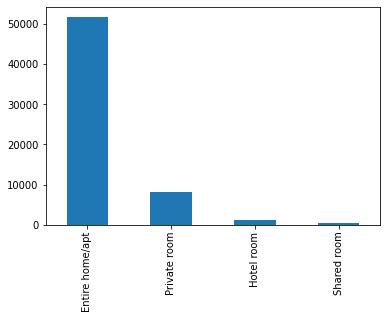

In [ ]:
df['room_type'].value_counts().plot(kind='bar')

In [ ]:
df.room_type.head(20)

0     Entire home/apt
1     Entire home/apt
2     Entire home/apt
3     Entire home/apt
4     Entire home/apt
5     Entire home/apt
6     Entire home/apt
7     Entire home/apt
8     Entire home/apt
9     Entire home/apt
10    Entire home/apt
11       Private room
12    Entire home/apt
13    Entire home/apt
14    Entire home/apt
15    Entire home/apt
16    Entire home/apt
17    Entire home/apt
18       Private room
19    Entire home/apt
Name: room_type, dtype: object

In [ ]:
df['room_type'] = df['room_type'].astype('category')
df['room_type'].head(20)

0     Entire home/apt
1     Entire home/apt
2     Entire home/apt
3     Entire home/apt
4     Entire home/apt
5     Entire home/apt
6     Entire home/apt
7     Entire home/apt
8     Entire home/apt
9     Entire home/apt
10    Entire home/apt
11       Private room
12    Entire home/apt
13    Entire home/apt
14    Entire home/apt
15    Entire home/apt
16    Entire home/apt
17    Entire home/apt
18       Private room
19    Entire home/apt
Name: room_type, dtype: category
Categories (4, object): ['Entire home/apt', 'Hotel room', 'Private room', 'Shared room']

In [ ]:
df['property_type'] = df['property_type'].astype('category')
df['property_type'].head(20)

0              Entire rental unit
1              Entire rental unit
2              Entire rental unit
3              Entire rental unit
4              Entire rental unit
5              Entire rental unit
6                     Entire loft
7              Entire rental unit
8              Entire rental unit
9              Entire rental unit
10                    Entire loft
11    Private room in rental unit
12             Entire rental unit
13             Entire rental unit
14                    Entire home
15             Entire rental unit
16             Entire rental unit
17             Entire rental unit
18    Private room in guest suite
19             Entire rental unit
Name: property_type, dtype: category
Categories (76, object): ['Boat', 'Casa particular', 'Cave', 'Dome', ...,
                          'Shared room in villa', 'Tent', 'Tiny home', 'Tower']

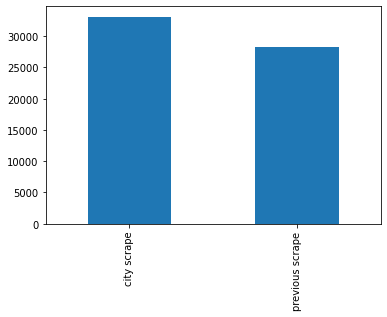

In [ ]:
df['source'].value_counts().plot(kind='bar')

In [ ]:
df['source'] = df['source'].astype('category')
df['source'].head(20)

0         city scrape
1         city scrape
2         city scrape
3     previous scrape
4         city scrape
5         city scrape
6         city scrape
7         city scrape
8     previous scrape
9         city scrape
10        city scrape
11        city scrape
12    previous scrape
13        city scrape
14        city scrape
15        city scrape
16        city scrape
17        city scrape
18        city scrape
19    previous scrape
Name: source, dtype: category
Categories (2, object): ['city scrape', 'previous scrape']

In [ ]:
df['neighbourhood_cleansed'] = df['neighbourhood_cleansed'].astype('category')
df['neighbourhood_cleansed'].head(20)

0                   Opéra
1       Buttes-Montmartre
2          Hôtel-de-Ville
3                  Temple
4          Hôtel-de-Ville
5     Batignolles-Monceau
6              Popincourt
7               Vaugirard
8            Ménilmontant
9                  Bourse
10        Buttes-Chaumont
11           Ménilmontant
12                  Opéra
13                  Passy
14        Buttes-Chaumont
15                 Louvre
16             Popincourt
17        Buttes-Chaumont
18      Buttes-Montmartre
19                Reuilly
Name: neighbourhood_cleansed, dtype: category
Categories (20, object): ['Batignolles-Monceau', 'Bourse', 'Buttes-Chaumont', 'Buttes-Montmartre', ...,
                          'Reuilly', 'Temple', 'Vaugirard', 'Élysée']

In [ ]:
df.host_response_time = df.host_response_time.fillna("Unknown")

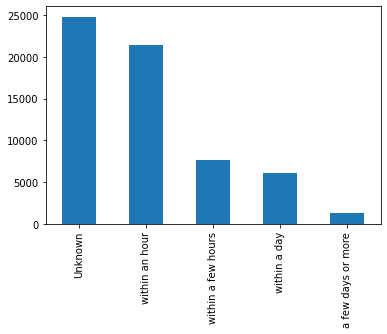

In [ ]:
df['host_response_time'].value_counts().plot(kind='bar')

In [ ]:
df['host_response_time'] = df['host_response_time'].astype('category')
df['host_response_time'].head(20)

0     within a few hours
1           within a day
2         within an hour
3                Unknown
4         within an hour
5     within a few hours
6         within an hour
7           within a day
8         within an hour
9     within a few hours
10               Unknown
11               Unknown
12               Unknown
13          within a day
14    within a few hours
15               Unknown
16        within an hour
17        within an hour
18        within an hour
19        within an hour
Name: host_response_time, dtype: category
Categories (5, object): ['Unknown', 'a few days or more', 'within a day', 'within a few hours',
                         'within an hour']

## 6. Sprawdzenie czy w zbiorze występują braki danych
W 3 kolumnach są 100% braki danych.
W częsci kolumn widać pojedyńcze braki, a w 30 kolumnach są braki 20% - 50%.

Kolumne 'bathrooms' można uzupełnić za pomocą kolumny 'bathrooms_text'

In [ ]:
df.isna().sum().sort_values(ascending=False)

neighbourhood_group_cleansed                    61365
calendar_updated                                61365
bathrooms                                       61365
host_about                                      32419
host_neighbourhood                              27427
neighbourhood                                   26146
neighborhood_overview                           26146
host_response_rate                              24815
license                                         24449
host_acceptance_rate                            22114
review_scores_value                             12466
review_scores_location                          12464
review_scores_checkin                           12462
review_scores_accuracy                          12452
review_scores_communication                     12451
review_scores_cleanliness                       12450
reviews_per_month                               11880
first_review                                    11880
last_review                 

In [ ]:
(df.isnull().mean() * 100).sort_values(ascending=False)

neighbourhood_group_cleansed                    100.000000
calendar_updated                                100.000000
bathrooms                                       100.000000
host_about                                       52.829789
host_neighbourhood                               44.694859
neighbourhood                                    42.607349
neighborhood_overview                            42.607349
host_response_rate                               40.438361
license                                          39.841929
host_acceptance_rate                             36.036829
review_scores_value                              20.314512
review_scores_location                           20.311252
review_scores_checkin                            20.307993
review_scores_accuracy                           20.291697
review_scores_communication                      20.290068
review_scores_cleanliness                        20.288438
reviews_per_month                                19.3595

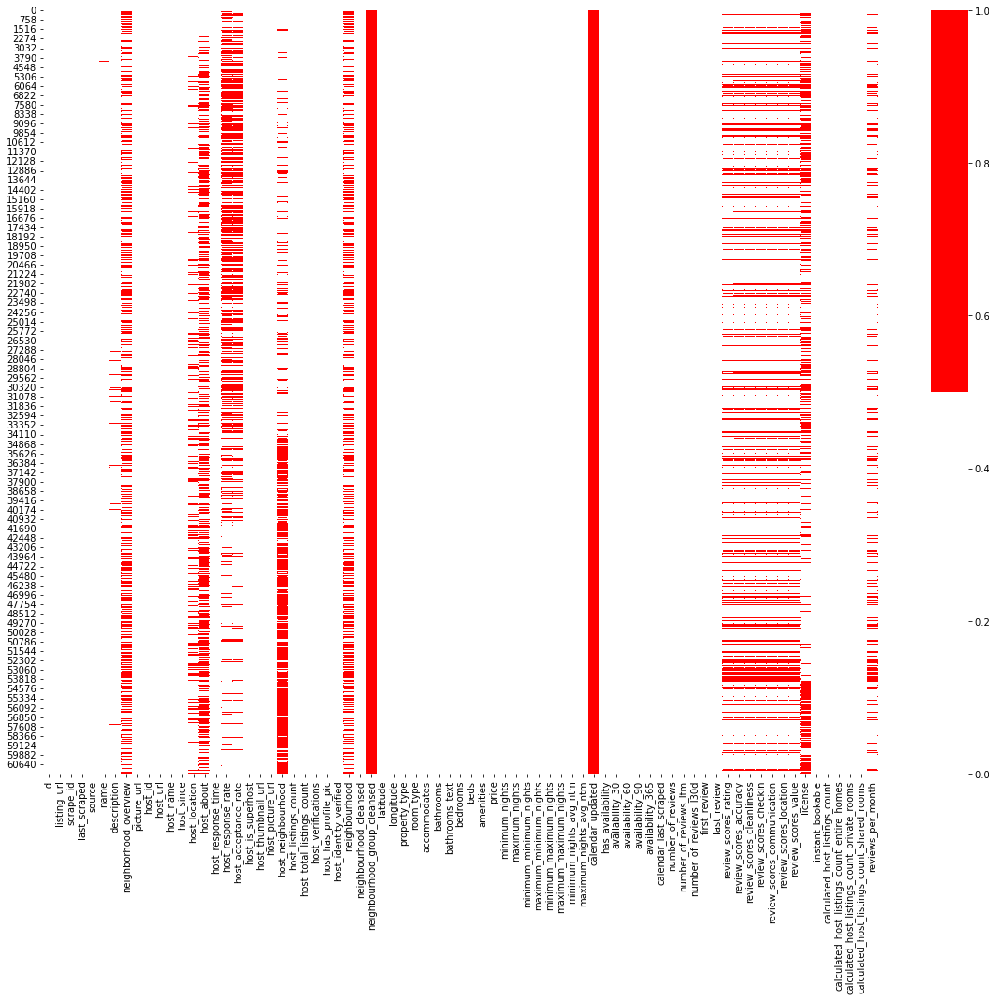

In [ ]:
fig, ax = plt.subplots(figsize=(20,15))

cols = df.columns
colours = ['#FFFFFF', '#FF0000'] # red - missing
sns.heatmap(df[cols].isna(), cmap=sns.color_palette(colours))
plt.show()

In [ ]:
df.price.describe()

count    61365.000000
mean       161.811326
std        301.441306
min          0.000000
25%         70.000000
50%        100.000000
75%        170.000000
max      12286.000000
Name: price, dtype: float64

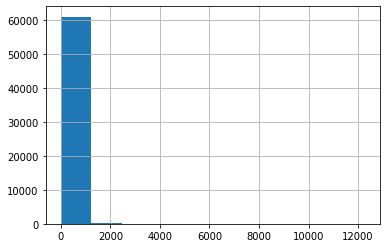

In [ ]:
hist_price=df["price"].hist()

Zmiana na typ danych datetime

In [ ]:
df['first_review'] = pd.to_datetime(df['first_review'])

In [ ]:
df.first_review.fillna(df.first_review.min(), inplace=True)

In [ ]:
df['first_review'].head(20)

0    2011-06-30
1    2010-04-04
2    2009-06-30
3    2011-06-11
4    2011-04-08
5    2010-04-08
6    2011-06-19
7    2010-05-09
8    2013-09-01
9    2011-06-15
10   2010-05-21
11   2013-10-16
12   2010-05-10
13   2015-04-13
14   2013-07-24
15   2009-06-30
16   2013-03-19
17   2011-05-21
18   2010-06-06
19   2010-07-11
Name: first_review, dtype: datetime64[ns]

In [ ]:
df['last_review'] = pd.to_datetime(df['last_review'])
df.last_review.fillna(df.last_review.max(), inplace=True)

In [ ]:
df['calendar_last_scraped'] = pd.to_datetime(df['calendar_last_scraped'])
df.calendar_last_scraped.fillna(df.calendar_last_scraped.max(), inplace=True)

In [ ]:
df['last_scraped'] = pd.to_datetime(df['last_scraped'])
df.last_scraped.fillna(df.last_scraped.max(), inplace=True)

In [ ]:
df['host_since'] = pd.to_datetime(df['host_since'])
df.host_since.fillna(df.host_since.min(), inplace=True)

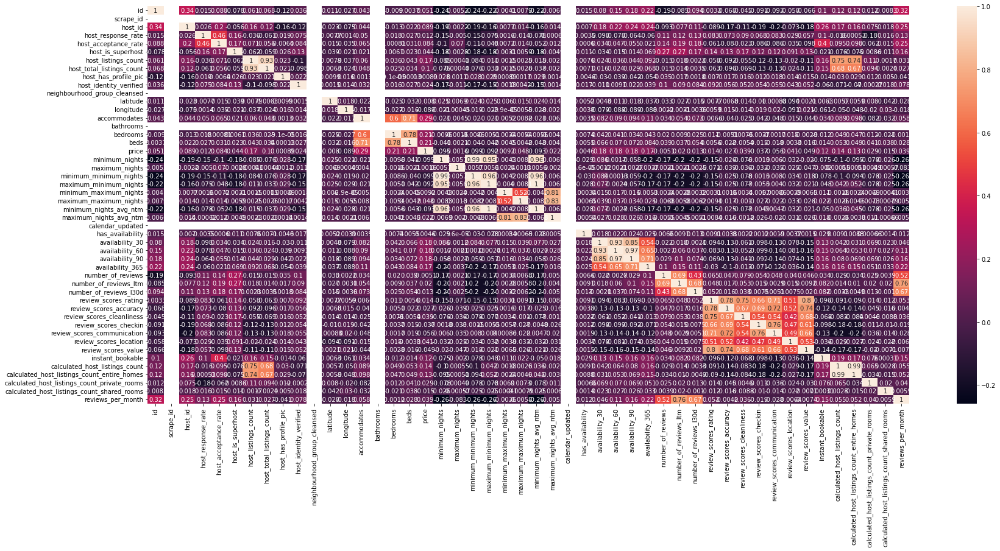

In [ ]:
corr = df.corr(method='pearson')
plt.figure(figsize=(28,12))
sns.heatmap(corr, annot=True)

In [ ]:
df.bathrooms_text.unique()

array(['1 bath', '2 baths', '1.5 baths', '1 private bath',
       '1 shared bath', nan, '2.5 baths', '1.5 shared baths', 'Half-bath',
       '4.5 baths', '2 shared baths', '4 baths', '3 baths', '0 baths',
       '3.5 baths', '0 shared baths', 'Shared half-bath',
       'Private half-bath', '5 baths', '2.5 shared baths', '6 baths',
       '8 baths', '3 shared baths', '7 baths', '50 baths',
       '6 shared baths', '5.5 baths', '3.5 shared baths', '26 baths',
       '4 shared baths', '7.5 baths', '20 shared baths', '20 baths'],
      dtype=object)

In [ ]:
df.bathrooms_text.str.split().str[0]

0                1
1                1
2                1
3                1
4                1
5                1
6                1
7                1
8                1
9                1
10               1
11               1
12               1
13               1
14               2
15               1
16               1
17             1.5
18               1
19               1
20               1
21             1.5
22               1
23               2
24               1
25               1
26               1
27               1
28             1.5
29               1
30               1
31               1
32               1
33               1
34               1
35               1
36               1
37               1
38               1
39               1
40               1
41             1.5
42               1
43               1
44               1
45               1
46               1
47               1
48               1
49               1
50               1
51               1
52          

In [ ]:
df.bathrooms_text.str.contains('half', case=False, regex=False)

0        False
1        False
2        False
3        False
4        False
5        False
6        False
7        False
8        False
9        False
10       False
11       False
12       False
13       False
14       False
15       False
16       False
17       False
18       False
19       False
20       False
21       False
22       False
23       False
24       False
25       False
26       False
27       False
28       False
29       False
30       False
31       False
32       False
33       False
34       False
35       False
36       False
37       False
38       False
39       False
40       False
41       False
42       False
43       False
44       False
45       False
46       False
47       False
48       False
49       False
50       False
51       False
52       False
53       False
54       False
55         NaN
56       False
57       False
58       False
59       False
60       False
61       False
62       False
63       False
64       False
65       False
66       F

In [ ]:
np.where(df.bathrooms_text.str.contains('half', case=False, regex=False, na = False),
         0.5,
         df.bathrooms_text.str.split().str[0]).astype(np.float64)

array([1., 1., 1., ..., 1., 1., 1.])

In [ ]:
df.bathrooms = np.where(df.bathrooms_text.str.contains('half', case=False, regex=False, na = False),
         0.5,
         df.bathrooms_text.str.split().str[0]).astype(np.float64)
df.bathrooms.head(20)

0     1.0
1     1.0
2     1.0
3     1.0
4     1.0
5     1.0
6     1.0
7     1.0
8     1.0
9     1.0
10    1.0
11    1.0
12    1.0
13    1.0
14    2.0
15    1.0
16    1.0
17    1.5
18    1.0
19    1.0
Name: bathrooms, dtype: float64

In [ ]:
df.bathrooms.fillna(df.bathrooms.min(), inplace=True)

In [ ]:
df.bathrooms_text.fillna('Unknown', inplace=True)

uzupełnienie kolumny 'beds' i 'bedrooms' za pomocą kolumny 'accommodates'

In [ ]:
np.where(df.beds.isna(),
         np.ceil(df.accommodates/2),
         df.beds
         )

array([2., 1., 1., ..., 2., 2., 1.])

In [ ]:
df.beds = np.where(df.beds.isna(),
         np.ceil(df.accommodates/2),
         df.beds
         )

In [ ]:
df.bedrooms = np.where(df.bedrooms.isna(),
         np.ceil(df.beds/2),
         df.bedrooms
         )

In [ ]:
df.beds.fillna(df.beds.min(), inplace=True)

In [ ]:
df.bedrooms.fillna(df.bedrooms.min(), inplace=True)

Uzupełnienie danych o wiadomość o braku danych.

In [ ]:
df.host_about = df.host_about.fillna("Nothing about host")

In [ ]:
df.host_neighbourhood = df.host_neighbourhood.fillna("Unknown")

In [ ]:
df.neighborhood_overview = df.neighborhood_overview.fillna("No Overview")

In [ ]:
df.license = df.license.fillna("Unknown")

In [ ]:
df.neighbourhood = df.neighbourhood.fillna("Unknown")

In [ ]:
df.host_location = df.host_location.fillna("Nothing about host location")

In [ ]:
df.description = df.description.fillna("No description")

In [ ]:
df.name = df.name.fillna("Unknown")

kolumny do wyrzucenia 100% braku danych, brak możliwości wypełnienia

In [ ]:
column_to_remove = ['calendar_updated', 'neighbourhood_group_cleansed']
df.drop(column_to_remove, inplace = True, axis = 1)

Kolumny do usunięcia, które są niekonieczne przydatne do analizy

In [ ]:
column_to_remove = ['minimum_minimum_nights', 'maximum_minimum_nights', 'minimum_maximum_nights', 'maximum_maximum_nights', 'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm', 'number_of_reviews_ltm', 'number_of_reviews_l30d']
df.drop(column_to_remove, inplace = True, axis = 1)

In [ ]:
df.kurt(numeric_only=True)

id                                                  0.249024
scrape_id                                           0.000000
host_id                                             0.086688
host_response_rate                                 11.898268
host_acceptance_rate                                1.813858
host_is_superhost                                   3.139764
host_listings_count                               123.367725
host_total_listings_count                         135.000734
host_has_profile_pic                               79.195528
host_identity_verified                              1.206116
latitude                                           -0.388734
longitude                                           0.427240
accommodates                                        7.068443
bathrooms                                        3035.113189
bedrooms                                         1063.184347
beds                                             1191.234477
price                   

Odcięcie odstających danych z kolumn maximum_nights i minimum_nights

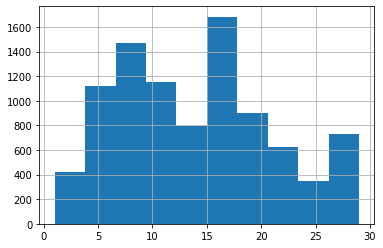

In [ ]:
hist_maxnight = df["maximum_nights"][df["maximum_nights"]<30].hist()
hist_maxnight

In [ ]:
df.maximum_nights.describe()

count    6.136500e+04
mean     8.479040e+02
std      4.037193e+04
min      1.000000e+00
25%      9.000000e+01
50%      1.125000e+03
75%      1.125000e+03
max      1.000000e+07
Name: maximum_nights, dtype: float64

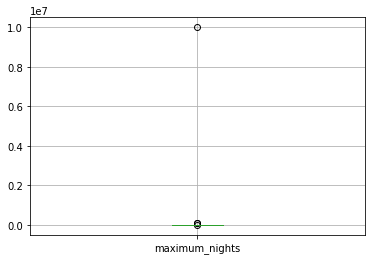

In [ ]:
df.boxplot('maximum_nights')

In [ ]:
Q1 = df['maximum_nights'].quantile(0.15)
Q3 = df['maximum_nights'].quantile(0.85)

df['maximum_nights'] = np.where(df["maximum_nights"] < Q1,
         Q1,
         df['maximum_nights'])

df['maximum_nights'] = np.where(df["maximum_nights"] > Q3,
         Q3,
         df['maximum_nights'])

In [ ]:
df.maximum_nights.describe()

count    61365.000000
mean       698.291371
std        472.703417
min         90.000000
25%         90.000000
50%       1125.000000
75%       1125.000000
max       1125.000000
Name: maximum_nights, dtype: float64

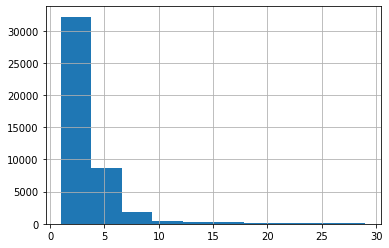

In [ ]:
hist_minnight = df["minimum_nights"][df["minimum_nights"]<30].hist()
hist_minnight

In [ ]:
df.minimum_nights.describe()

count    61365.000000
mean        81.193514
std        151.562180
min          1.000000
25%          2.000000
50%          3.000000
75%         30.000000
max       9999.000000
Name: minimum_nights, dtype: float64

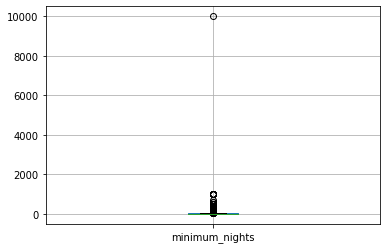

In [ ]:
df.boxplot('minimum_nights')

In [ ]:
Q1 = df['minimum_nights'].quantile(0.15)
Q3 = df['minimum_nights'].quantile(0.85)

df['minimum_nights'] = np.where(df["minimum_nights"] < Q1,
         Q1,
         df['minimum_nights'])

df['minimum_nights'] = np.where(df["minimum_nights"] > Q3,
         Q3,
         df['minimum_nights'])

In [ ]:
df.minimum_nights.describe()

count    61365.000000
mean        10.867009
std         12.203316
min          2.000000
25%          2.000000
50%          3.000000
75%         30.000000
max         30.000000
Name: minimum_nights, dtype: float64

odcinanie skrajnych wartosci w ocenach ("review")

In [ ]:
df.review_scores_value.describe()

count    48899.000000
mean         4.611347
std          0.461448
min          0.000000
25%          4.500000
50%          4.710000
75%          4.890000
max          5.000000
Name: review_scores_value, dtype: float64

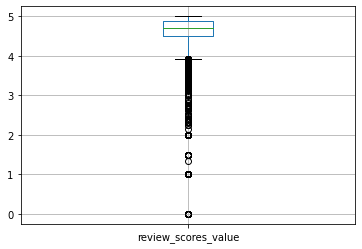

In [ ]:
df.boxplot('review_scores_value')

In [ ]:
Q1 = df['review_scores_value'].quantile(0.15)
Q3 = df['review_scores_value'].quantile(0.90)

df['review_scores_value'] = np.where(df["review_scores_value"] < Q1,
         Q1,
         df['review_scores_value'])

df['review_scores_value'] = np.where(df["review_scores_value"] > Q3,
         Q3,
         df['review_scores_value'])

In [ ]:
df['review_scores_value'].head(20)

0     4.43
1     4.64
2     4.54
3     4.50
4     4.72
5     4.64
6     4.61
7     4.98
8     4.55
9     4.79
10    4.48
11    4.80
12    5.00
13    4.85
14    4.88
15     NaN
16    4.90
17    4.87
18    4.45
19    4.90
Name: review_scores_value, dtype: float64

In [ ]:
df.number_of_reviews.describe()

count    61365.000000
mean        23.910894
std         51.986093
min          0.000000
25%          1.000000
50%          6.000000
75%         24.000000
max       2391.000000
Name: number_of_reviews, dtype: float64

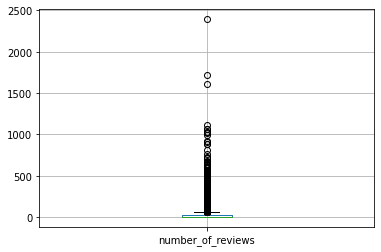

In [ ]:
df.boxplot('number_of_reviews')

uzupelnienie danych za pomoca przybliżenia, mediany

In [ ]:
df.review_scores_value.head(20)

0     4.43
1     4.64
2     4.54
3     4.50
4     4.72
5     4.64
6     4.61
7     4.98
8     4.55
9     4.79
10    4.48
11    4.80
12    5.00
13    4.85
14    4.88
15     NaN
16    4.90
17    4.87
18    4.45
19    4.90
Name: review_scores_value, dtype: float64

In [ ]:
med = df.review_scores_value.median()
med

4.71

In [ ]:
df.review_scores_value = df.review_scores_value.fillna(med)

In [ ]:
df.review_scores_value.head(20)

0     4.43
1     4.64
2     4.54
3     4.50
4     4.72
5     4.64
6     4.61
7     4.98
8     4.55
9     4.79
10    4.48
11    4.80
12    5.00
13    4.85
14    4.88
15    4.71
16    4.90
17    4.87
18    4.45
19    4.90
Name: review_scores_value, dtype: float64

In [ ]:
df.isna().sum().sort_values(ascending=False)

host_response_rate                              24815
host_acceptance_rate                            22114
review_scores_location                          12464
review_scores_checkin                           12462
review_scores_accuracy                          12452
review_scores_communication                     12451
review_scores_cleanliness                       12450
reviews_per_month                               11880
review_scores_rating                            11880
host_listings_count                                 7
host_name                                           7
host_thumbnail_url                                  7
host_picture_url                                    7
host_total_listings_count                           7
picture_url                                         1
number_of_reviews                                   0
price                                               0
minimum_nights                                      0
maximum_nights              

In [ ]:
mean = df.review_scores_location.mean()

df.review_scores_location = df.review_scores_location.fillna(mean)

In [ ]:
med = df.review_scores_checkin.median()

df.review_scores_checkin = df.review_scores_checkin.fillna(med)

In [ ]:
mean = df.review_scores_accuracy.mean()

df.review_scores_accuracy = df.review_scores_accuracy.fillna(mean)

In [ ]:
med = df.review_scores_communication.median()

df.review_scores_communication = df.review_scores_communication.fillna(med)

In [ ]:
mean = df.review_scores_cleanliness.mean()

df.review_scores_cleanliness = df.review_scores_cleanliness.fillna(mean)

In [ ]:
mean = df.reviews_per_month.mean()

df.reviews_per_month = df.reviews_per_month.fillna(mean)

In [ ]:
mean = df.review_scores_rating.mean()

df.review_scores_rating = df.review_scores_rating.fillna(mean)

In [ ]:
df.host_response_rate.fillna(0)

0        1.00
1        1.00
2        1.00
3        0.00
4        1.00
5        1.00
6        0.90
7        1.00
8        1.00
9        1.00
10       0.00
11       0.00
12       0.00
13       1.00
14       1.00
15       0.00
16       1.00
17       1.00
18       1.00
19       1.00
20       1.00
21       0.00
22       0.00
23       0.00
24       1.00
25       1.00
26       0.00
27       1.00
28       0.96
29       1.00
30       1.00
31       1.00
32       0.00
33       1.00
34       1.00
35       1.00
36       1.00
37       1.00
38       0.71
39       1.00
40       1.00
41       1.00
42       1.00
43       0.00
44       1.00
45       0.00
46       1.00
47       0.00
48       0.00
49       0.80
50       0.00
51       0.00
52       0.00
53       0.00
54       0.80
55       0.00
56       0.00
57       1.00
58       0.98
59       1.00
60       0.90
61       1.00
62       1.00
63       1.00
64       0.19
65       1.00
66       1.00
67       1.00
68       0.50
69       1.00
70       0.19
71    

In [ ]:
df.host_acceptance_rate.fillna(0)

0        0.92
1        1.00
2        0.99
3        0.00
4        0.70
5        0.75
6        0.80
7        0.00
8        0.60
9        1.00
10       0.00
11       0.00
12       0.00
13       0.63
14       0.90
15       0.00
16       1.00
17       0.63
18       0.84
19       0.98
20       0.00
21       0.00
22       0.00
23       0.00
24       1.00
25       0.55
26       0.00
27       1.00
28       0.90
29       0.57
30       0.90
31       0.57
32       0.00
33       0.95
34       1.00
35       0.29
36       1.00
37       0.86
38       0.74
39       0.85
40       0.09
41       1.00
42       1.00
43       0.00
44       0.70
45       0.00
46       0.77
47       0.00
48       0.00
49       0.75
50       0.00
51       0.00
52       0.00
53       0.00
54       0.29
55       0.00
56       0.00
57       0.91
58       0.02
59       0.86
60       0.55
61       0.83
62       1.00
63       0.00
64       0.28
65       1.00
66       0.94
67       0.99
68       0.14
69       1.00
70       0.28
71    

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'source', 'name',
       'description', 'neighborhood_overview', 'picture_url', 'host_id',
       'host_url', 'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'latitude', 'longitude', 'property_type',
       'room_type', 'accommodates', 'bathrooms', 'bathrooms_text', 'bedrooms',
       'beds', 'amenities', 'price', 'minimum_nights', 'maximum_nights',
       'has_availability', 'availability_30', 'availability_60',
       'availability_90', 'availability_365', 'calendar_last_scraped',
       'number_of_reviews', 'first_review', 'last_review',
       'review_scores_ra

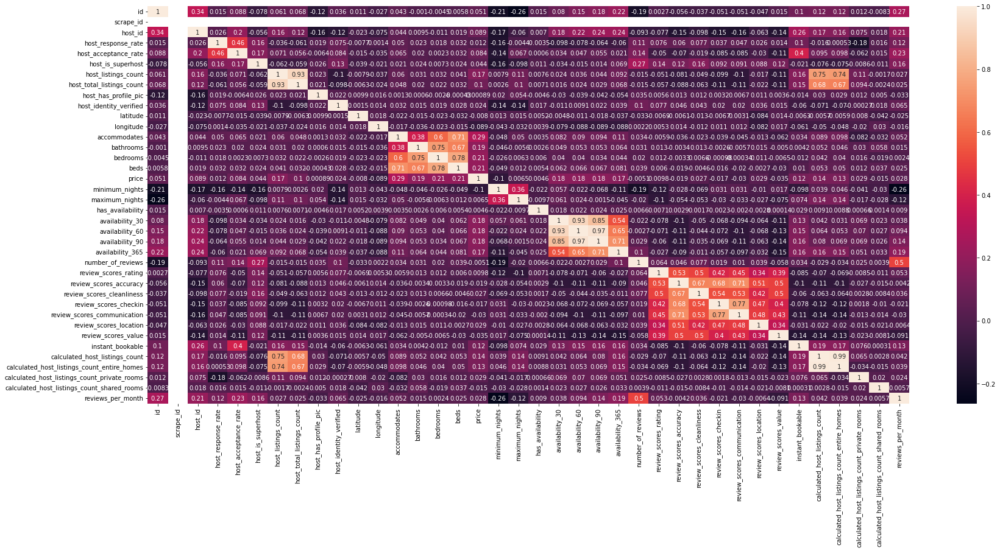

In [ ]:
corr = df.corr(method='pearson')
plt.figure(figsize=(28,12))
sns.heatmap(corr, annot=True)

In [ ]:
df.host_verifications.unique()

array(["['email', 'phone']", "['email', 'phone', 'work_email']",
       "['phone']", "['email']", '[]', "['phone', 'work_email']", 'None',
       "['email', 'work_email']", "['email', 'phone', 'photographer']"],
      dtype=object)

In [ ]:
df.host_verifications.str[1:-1].replace("[' ]", '', regex = True).str.split(',').drop_duplicates()

0                      [email, phone]
5          [email, phone, work_email]
12                            [phone]
43                            [email]
55                                 []
723               [phone, work_email]
3716                             [on]
5768              [email, work_email]
40014    [email, phone, photographer]
Name: host_verifications, dtype: object

In [ ]:
df.host_verifications = df.host_verifications.str[1:-1].replace("[' ]", '', regex = True).str.split(',')
df.host_verifications

0                      [email, phone]
1                      [email, phone]
2                      [email, phone]
3                      [email, phone]
4                      [email, phone]
5          [email, phone, work_email]
6                      [email, phone]
7                      [email, phone]
8                      [email, phone]
9                      [email, phone]
10                     [email, phone]
11                     [email, phone]
12                            [phone]
13                     [email, phone]
14                     [email, phone]
15                     [email, phone]
16                     [email, phone]
17                     [email, phone]
18                     [email, phone]
19                     [email, phone]
20         [email, phone, work_email]
21                     [email, phone]
22                     [email, phone]
23                     [email, phone]
24                     [email, phone]
25         [email, phone, work_email]
26          

In [ ]:
df.amenities[df.amenities.str.contains('\\', regex = False)]

0        ["Ethernet connection", "Hair dryer", "Hangers...
4        ["Dryer", "Hair dryer", "Hangers", "Kitchen", ...
7        ["Hair dryer", "Toaster", "Hangers", "Kitchen"...
12       ["Hair dryer", "Toaster", "Hangers", "Kitchen"...
19       ["Hair dryer", "Toaster", "Hangers", "Kitchen"...
22       ["Hair dryer", "Backyard", "Hangers", "Kitchen...
26       ["Ethernet connection", "Hair dryer", "Hangers...
27       ["Ethernet connection", "Hair dryer", "Toaster...
28       ["Ethernet connection", "Hair dryer", "Hangers...
30       ["Ethernet connection", "Hair dryer", "Toaster...
34       ["Single level home", "Heating", "Bed linens",...
39       ["Ethernet connection", "Hair dryer", "Hangers...
41       ["Ethernet connection", "Hair dryer", "Toaster...
42       ["Hair dryer", "Hangers", "Kitchen", "Washer \...
43       ["Ethernet connection", "Hair dryer", "Toaster...
44       ["Hangers", "Kitchen", "Washer \u2013\u00a0In ...
57       ["Ethernet connection", "Hair dryer", "Toaster.

In [ ]:
import json
am = df.amenities.apply(json.loads)

In [ ]:
am

0        [Ethernet connection, Hair dryer, Hangers, Kit...
1        [Heating, Hair dryer, Cooking basics, Smoke al...
2        [Hair dryer, Toaster, Hangers, Kitchen, Extra ...
3        [Heating, Elevator, Smoke alarm, Kitchen, Wash...
4        [Dryer, Hair dryer, Hangers, Kitchen, Extra pi...
5        [Heating, Cooking basics, Elevator, Smoke alar...
6        [Heating, Dryer, Hair dryer, Cooking basics, O...
7        [Hair dryer, Toaster, Hangers, Kitchen, Extra ...
8        [Oven, Bed linens, Smoke alarm, Paid parking o...
9        [Ethernet connection, Dryer, Hair dryer, Hange...
10       [Heating, Hair dryer, Smoke alarm, Iron, Hange...
11       [Heating, Dryer, Hair dryer, Iron, Kitchen, Wa...
12       [Hair dryer, Toaster, Hangers, Kitchen, Essent...
13       [Heating, Smoke alarm, Fire extinguisher, Kitc...
14       [Dryer, Hair dryer, Hangers, Kitchen, Essentia...
15       [Heating, Hair dryer, Elevator, Kitchen, Dedic...
16       [Hair dryer, Hangers, Kitchen, Extra pillows a.

In [ ]:
district = df.neighbourhood_cleansed.value_counts(normalize = True)
px.pie(district, values=district.values, names=district.index, width=1000)

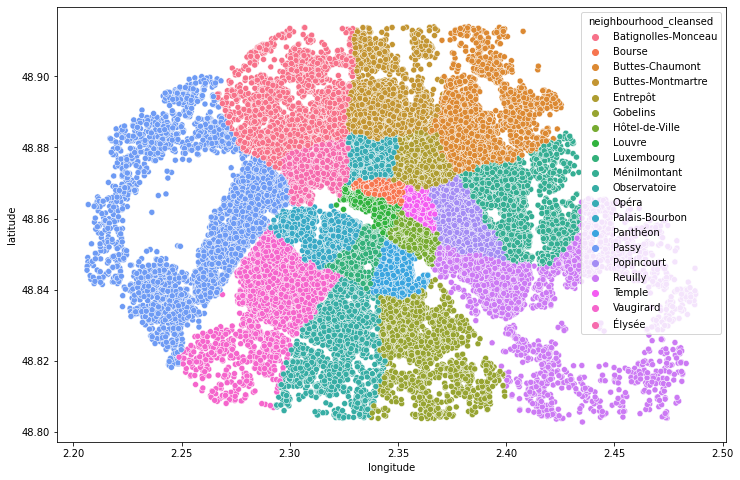

In [ ]:
plt.figure(figsize=(12, 8))
sns.scatterplot(data=df, x='longitude', y='latitude', hue='neighbourhood_cleansed');
#px.scatter(df, x='longitude', y='latitude', color='neighbourhood_cleansed')

In [ ]:
px.scatter(df, x='longitude', y='latitude', color='neighbourhood_cleansed')

In [ ]:
px.scatter(df, x='longitude', y='latitude', color='property_type')

In [ ]:
px.scatter(df, x='longitude', y='latitude', color='room_type')

In [ ]:
px.box(df, x='neighbourhood_cleansed', y='price', title='Prices per day', color = "room_type")

In [ ]:
px.box(df[df.price < 3000], x='neighbourhood_cleansed', y='price', title='Prices per day') #zmniejszenie zakresu, aby dokładniej zobaczyć

In [ ]:
px.box(df, x='room_type', y='price')

In [ ]:
px.scatter(df, x='longitude', y='latitude', color='neighbourhood_cleansed', size ='price', size_max=50, hover_name='neighbourhood', symbol ='room_type')
#px.scatter(df, x='longitude', y='latitude', color='neighbourhood_cleansed', text ='price', hover_name='neighbourhood')